In [67]:
import torch
import json
import h5py
import numpy as np
from matplotlib.pyplot import imshow
from PIL import Image, ImageDraw

In [68]:
image_file = json.load(open('/home/suji/spring20/suji/Scene-Graph-Benchmark.pytorch/datasets/vg/image_data.json'))
vocab_file = json.load(open('/home/suji/spring20/KERN/data/stanford_filtered/VG-SGG-dicts.json'))
data_file = h5py.File('/home/suji/spring20/KERN/data/stanford_filtered/VG-SGG.h5', 'r')
# remove invalid image
corrupted_ims = [1592, 1722, 4616, 4617]
tmp = []
for item in image_file:
    if int(item['image_id']) not in corrupted_ims:
        tmp.append(item)
image_file = tmp

In [69]:
image_file

[{'width': 800,
  'url': 'https://cs.stanford.edu/people/rak248/VG_100K_2/1.jpg',
  'height': 600,
  'image_id': 1,
  'coco_id': None,
  'flickr_id': None,
  'anti_prop': 0.0},
 {'width': 800,
  'url': 'https://cs.stanford.edu/people/rak248/VG_100K/2.jpg',
  'height': 600,
  'image_id': 2,
  'coco_id': None,
  'flickr_id': None,
  'anti_prop': 0.013408184535413127},
 {'width': 640,
  'url': 'https://cs.stanford.edu/people/rak248/VG_100K/3.jpg',
  'height': 480,
  'image_id': 3,
  'coco_id': None,
  'flickr_id': None,
  'anti_prop': 0.022906517566696358},
 {'width': 640,
  'url': 'https://cs.stanford.edu/people/rak248/VG_100K/4.jpg',
  'height': 480,
  'image_id': 4,
  'coco_id': None,
  'flickr_id': None,
  'anti_prop': 0.031526806903996396},
 {'width': 800,
  'url': 'https://cs.stanford.edu/people/rak248/VG_100K/5.jpg',
  'height': 600,
  'image_id': 5,
  'coco_id': None,
  'flickr_id': None,
  'anti_prop': 0.011503879692610493},
 {'width': 800,
  'url': 'https://cs.stanford.edu/peopl

In [70]:
# load detected results
detected_origin_path = '/home/suji/inference/VG_stanford_filtered_with_attribute_test/'
detected_origin_result = torch.load(detected_origin_path + 'eval_results.pytorch')
detected_info = json.load(open(detected_origin_path + 'visual_info.json'))

In [71]:
# get image info by index
def get_info_by_idx(idx, det_input, thres=0.5):
    groundtruth = det_input['groundtruths'][idx]
    prediction = det_input['predictions'][idx]
    # image path
    img_path = detected_info[idx]['img_file']
    # boxes
    boxes = groundtruth.bbox
    # object labels
    idx2label = vocab_file['idx_to_label']
    labels = ['{}-{}'.format(idx,idx2label[str(i)]) for idx, i in enumerate(groundtruth.get_field('labels').tolist())]
    pred_labels = ['{}-{}'.format(idx,idx2label[str(i)]) for idx, i in enumerate(prediction.get_field('pred_labels').tolist())]
    # groundtruth relation triplet
    idx2pred = vocab_file['idx_to_predicate']
    gt_rels = groundtruth.get_field('relation_tuple').tolist()
    gt_rels = [(labels[i[0]], idx2pred[str(i[2])], labels[i[1]]) for i in gt_rels]
    # prediction relation triplet
    pred_rel_pair = prediction.get_field('rel_pair_idxs').tolist()
    pred_rel_label = prediction.get_field('pred_rel_scores')
    pred_rel_label[:,0] = 0
    pred_rel_score, pred_rel_label = pred_rel_label.max(-1)
    #mask = pred_rel_score > thres
    #pred_rel_score = pred_rel_score[mask]
    #pred_rel_label = pred_rel_label[mask]
    pred_rels = [(pred_labels[i[0]], idx2pred[str(j)], pred_labels[i[1]]) for i, j in zip(pred_rel_pair, pred_rel_label.tolist())]
    return img_path, boxes, labels, gt_rels, pred_rels, pred_rel_score, pred_rel_label

In [72]:
def draw_single_box(pic, box, color='red', draw_info=None):
    draw = ImageDraw.Draw(pic)
    x1,y1,x2,y2 = int(box[0]), int(box[1]), int(box[2]), int(box[3])
    draw.rectangle(((x1, y1), (x2, y2)), outline=color)
    if draw_info:
        draw.rectangle(((x1, y1), (x1+50, y1+10)), fill=color)
        info = draw_info
        draw.text((x1, y1), info)

def print_list(name, input_list):
    for i, item in enumerate(input_list):
        print(name + ' ' + str(i) + ': ' + str(item))
    
def draw_image(img_path, boxes, labels, gt_rels, pred_rels, pred_rel_score, pred_rel_label, print_img=True):
    pic = Image.open(img_path)
    num_obj = boxes.shape[0]
    for i in range(num_obj):
        info = labels[i]
        draw_single_box(pic, boxes[i], draw_info=info)
    if print_img:
        display(pic)
    if print_img:
        print('*' * 50)
        print_list('gt_boxes', labels)
        print('*' * 50)
        print_list('gt_rels', gt_rels)
        print('*' * 50)
    print_list('pred_rels', pred_rels[:20])
    print('*' * 50)
    
    return None

In [73]:
def show_selected(idx_list):
    for select_idx in idx_list:
        print(select_idx)
        draw_image(*get_info_by_idx(select_idx, detected_origin_result))
        
def show_all(start_idx, length):
    for cand_idx in range(start_idx, start_idx+length):
        print(cand_idx)
        draw_image(*get_info_by_idx(cand_idx, detected_origin_result))

0


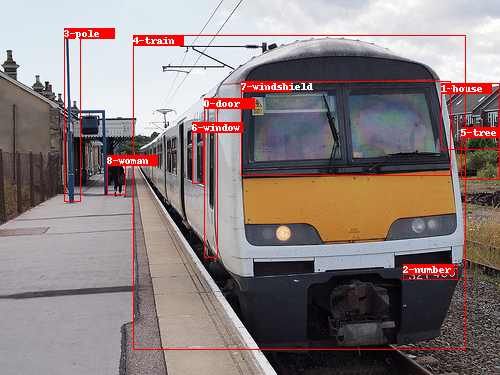

**************************************************
gt_boxes 0: 0-door
gt_boxes 1: 1-house
gt_boxes 2: 2-number
gt_boxes 3: 3-pole
gt_boxes 4: 4-train
gt_boxes 5: 5-tree
gt_boxes 6: 6-window
gt_boxes 7: 7-windshield
gt_boxes 8: 8-woman
**************************************************
gt_rels 0: ('7-windshield', 'on', '4-train')
gt_rels 1: ('6-window', 'on', '4-train')
gt_rels 2: ('4-train', 'has', '6-window')
gt_rels 3: ('1-house', 'near', '4-train')
gt_rels 4: ('5-tree', 'near', '1-house')
**************************************************
pred_rels 0: ('13-train', 'has', '57-window')
pred_rels 1: ('11-house', 'behind', '13-train')
pred_rels 2: ('13-train', 'in front of', '11-house')
pred_rels 3: ('2-people', 'watching', '13-train')
pred_rels 4: ('24-building', 'behind', '13-train')
pred_rels 5: ('34-sidewalk', 'near', '13-train')
pred_rels 6: ('13-train', 'has', '1-window')
pred_rels 7: ('2-people', 'walking on', '34-sidewalk')
pred_rels 8: ('13-train', 'in front of', '24-building')

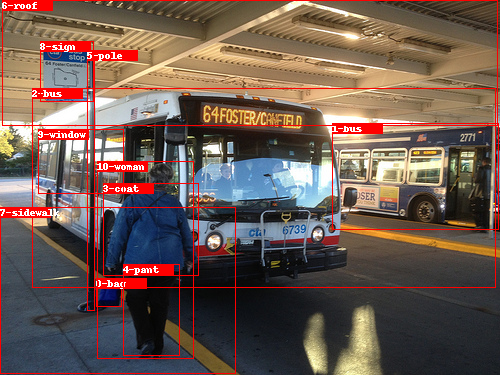

**************************************************
gt_boxes 0: 0-bag
gt_boxes 1: 1-bus
gt_boxes 2: 2-bus
gt_boxes 3: 3-coat
gt_boxes 4: 4-pant
gt_boxes 5: 5-pole
gt_boxes 6: 6-roof
gt_boxes 7: 7-sidewalk
gt_boxes 8: 8-sign
gt_boxes 9: 9-window
gt_boxes 10: 10-woman
**************************************************
gt_rels 0: ('2-bus', 'under', '6-roof')
gt_rels 1: ('10-woman', 'near', '2-bus')
gt_rels 2: ('9-window', 'on', '2-bus')
gt_rels 3: ('10-woman', 'wearing', '3-coat')
**************************************************
pred_rels 0: ('16-bus', 'parked on', '46-street')
pred_rels 1: ('2-woman', 'walking on', '46-street')
pred_rels 2: ('2-woman', 'wearing', '37-jacket')
pred_rels 3: ('16-bus', 'behind', '2-woman')
pred_rels 4: ('2-woman', 'wearing', '1-pant')
pred_rels 5: ('11-bus', 'has', '27-windshield')
pred_rels 6: ('37-jacket', 'on', '2-woman')
pred_rels 7: ('16-bus', 'has', '45-door')
pred_rels 8: ('11-bus', 'behind', '2-woman')
pred_rels 9: ('11-bus', 'parked on', '46-stree

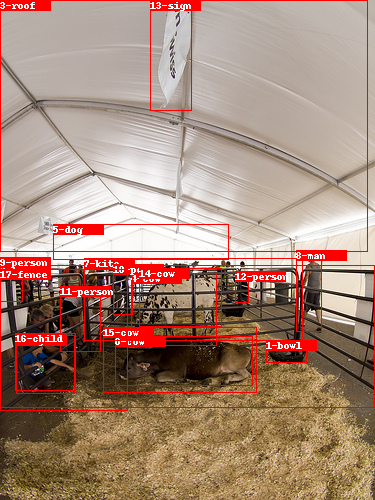

**************************************************
gt_boxes 0: 0-cow
gt_boxes 1: 1-bowl
gt_boxes 2: 2-boy
gt_boxes 3: 3-roof
gt_boxes 4: 4-cow
gt_boxes 5: 5-dog
gt_boxes 6: 6-fence
gt_boxes 7: 7-kite
gt_boxes 8: 8-man
gt_boxes 9: 9-person
gt_boxes 10: 10-person
gt_boxes 11: 11-person
gt_boxes 12: 12-person
gt_boxes 13: 13-sign
gt_boxes 14: 14-cow
gt_boxes 15: 15-cow
gt_boxes 16: 16-child
gt_boxes 17: 17-fence
**************************************************
gt_rels 0: ('13-sign', 'hanging from', '3-roof')
gt_rels 1: ('6-fence', 'near', '0-cow')
**************************************************
pred_rels 0: ('2-fence', 'under', '20-roof')
pred_rels 1: ('66-sign', 'above', '9-cow')
pred_rels 2: ('1-man', 'watching', '9-cow')
pred_rels 3: ('1-man', 'standing on', '2-fence')
pred_rels 4: ('2-fence', 'in front of', '9-cow')
pred_rels 5: ('9-cow', 'has', '8-head')
pred_rels 6: ('66-sign', 'above', '1-man')
pred_rels 7: ('20-roof', 'above', '9-cow')
pred_rels 8: ('74-cow', 'has', '8-head')

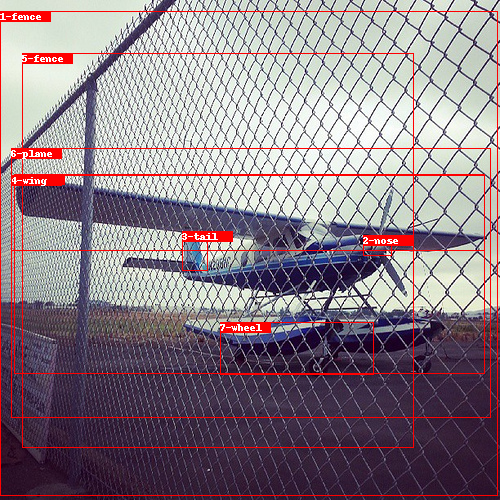

**************************************************
gt_boxes 0: 0-plane
gt_boxes 1: 1-fence
gt_boxes 2: 2-nose
gt_boxes 3: 3-tail
gt_boxes 4: 4-wing
gt_boxes 5: 5-fence
gt_boxes 6: 6-plane
gt_boxes 7: 7-wheel
**************************************************
gt_rels 0: ('4-wing', 'on', '6-plane')
gt_rels 1: ('0-plane', 'has', '3-tail')
gt_rels 2: ('1-fence', 'in front of', '0-plane')
gt_rels 3: ('7-wheel', 'on', '6-plane')
gt_rels 4: ('4-wing', 'on', '0-plane')
**************************************************
pred_rels 0: ('11-boat', 'behind', '16-fence')
pred_rels 1: ('11-boat', 'behind', '19-fence')
pred_rels 2: ('16-fence', 'near', '11-boat')
pred_rels 3: ('32-boat', 'behind', '16-fence')
pred_rels 4: ('10-fence', 'behind', '16-fence')
pred_rels 5: ('16-fence', 'behind', '19-fence')
pred_rels 6: ('10-fence', 'near', '11-boat')
pred_rels 7: ('19-fence', 'in front of', '11-boat')
pred_rels 8: ('44-boat', 'behind', '16-fence')
pred_rels 9: ('19-fence', 'behind', '16-fence')
pred_rels

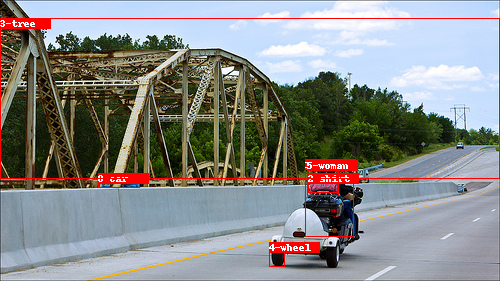

**************************************************
gt_boxes 0: 0-car
gt_boxes 1: 1-people
gt_boxes 2: 2-shirt
gt_boxes 3: 3-tree
gt_boxes 4: 4-wheel
gt_boxes 5: 5-woman
**************************************************
gt_rels 0: ('5-woman', 'wearing', '2-shirt')
gt_rels 1: ('5-woman', 'wearing', '2-shirt')
**************************************************
pred_rels 0: ('10-woman', 'riding', '13-motorcycle')
pred_rels 1: ('10-woman', 'wearing', '74-shirt')
pred_rels 2: ('4-tower', 'behind', '10-woman')
pred_rels 3: ('56-person', 'riding', '13-motorcycle')
pred_rels 4: ('4-tower', 'behind', '13-motorcycle')
pred_rels 5: ('13-motorcycle', 'has', '29-wheel')
pred_rels 6: ('74-shirt', 'on', '10-woman')
pred_rels 7: ('56-person', 'wearing', '74-shirt')
pred_rels 8: ('13-motorcycle', 'wearing', '74-shirt')
pred_rels 9: ('49-woman', 'riding', '13-motorcycle')
pred_rels 10: ('49-woman', 'wearing', '74-shirt')
pred_rels 11: ('4-tower', 'behind', '56-person')
pred_rels 12: ('4-tower', 'behind'

In [74]:
show_all(start_idx=0, length=5)
#show_selected([119, 967, 713, 5224, 19681, 25371])

# VCR

In [59]:
# load detected results
ndetected_origin_path = '/home/suji/vcr_test/'
# ndetected_origin_path = '/home/suji/checkpoints/causal-motifs-sgcls-exmp/inference/vcr_test/'
ndetected_origin_result = torch.load(ndetected_origin_path + 'eval_results.pytorch')
ndetected_info = json.load(open(ndetected_origin_path + 'visual_info.json'))

In [22]:
# import glob
# filenames = glob.glob('/home/suji/spring20/vilbert_beta/data/VCR/vcr1images/*/*.jpg')[:30]

In [57]:
# ndetected_info[0]['img_file']
ndetected_info

[{'img_file': '/home/suji/spring20/vilbert_beta/data/VCR/vcr1images/lsmdc_0001_American_Beauty/0001_American_Beauty_00.00.56.224-00.01.03.394@0.jpg',
  'prediction': [[252.01202392578125,
    60.85776901245117,
    1534.6546630859375,
    799.4334106445312,
    'woman'],
   [269.309326171875,
    362.9859619140625,
    781.7417602539062,
    811.4368896484375,
    'hand'],
   [1460.66064453125,
    413.6407775878906,
    1572.1322021484375,
    523.352783203125,
    'leg'],
   [1728.768798828125,
    274.64019775390625,
    1911.3514404296875,
    369.70794677734375,
    'hand'],
   [539.57958984375,
    110.31220245361328,
    1918.078125,
    788.8703002929688,
    'man'],
   [1572.1322021484375, 435.0069885253906, 1629.789794921875, 616.5, 'finger'],
   [860.06005859375,
    174.65098571777344,
    1909.429443359375,
    820.0794067382812,
    'bed'],
   [357.47747802734375,
    418.4421691894531,
    1201.201171875,
    803.754638671875,
    'shirt'],
   [462.7027282714844,
    65.

In [43]:
detected_origin_result

{'groundtruths': [BoxList(num_boxes=9, image_width=500, image_height=375, mode=xyxy),
  BoxList(num_boxes=11, image_width=500, image_height=375, mode=xyxy),
  BoxList(num_boxes=18, image_width=375, image_height=500, mode=xyxy),
  BoxList(num_boxes=8, image_width=500, image_height=500, mode=xyxy),
  BoxList(num_boxes=6, image_width=500, image_height=281, mode=xyxy),
  BoxList(num_boxes=6, image_width=500, image_height=199, mode=xyxy),
  BoxList(num_boxes=15, image_width=500, image_height=375, mode=xyxy),
  BoxList(num_boxes=13, image_width=365, image_height=500, mode=xyxy),
  BoxList(num_boxes=15, image_width=500, image_height=281, mode=xyxy),
  BoxList(num_boxes=16, image_width=500, image_height=332, mode=xyxy),
  BoxList(num_boxes=21, image_width=500, image_height=333, mode=xyxy),
  BoxList(num_boxes=31, image_width=500, image_height=322, mode=xyxy),
  BoxList(num_boxes=28, image_width=500, image_height=333, mode=xyxy),
  BoxList(num_boxes=13, image_width=500, image_height=375, mode=x

In [58]:
ndetected_origin_result

{'groundtruths': [],
 'predictions': [BoxList(num_boxes=80, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=80, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=80, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=80, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=80, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=80, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=80, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=80, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=80, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=80, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=80, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=80, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=80, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=80, imag

In [47]:
# groundtruth = ndetected_origin_result['groundtruths'][0]
# prediction = ndetected_origin_result['predictions'][0]

In [75]:
ndetected_origin_result

{'groundtruths': [BoxList(num_boxes=3, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=3, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=3, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=5, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=5, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=4, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=6, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=5, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=6, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=5, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=4, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=20, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=8, image_width=1920, image_height=822, mode=xyxy),
  BoxList(num_boxes=17, image_width=1920, image_height=822, 

In [79]:
ndetected_origin_result['predictions'][0]

BoxList(num_boxes=80, image_width=1920, image_height=822, mode=xyxy)

0


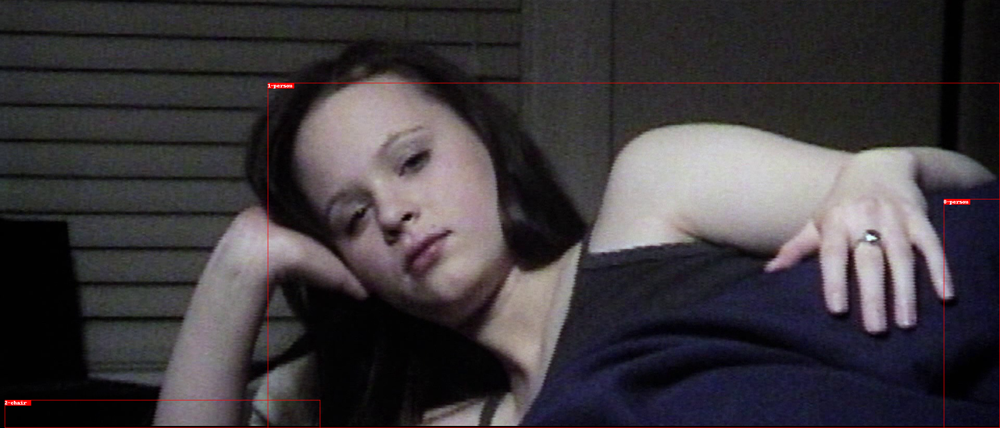

**************************************************
gt_boxes 0: 0-person
gt_boxes 1: 1-person
gt_boxes 2: 2-chair
**************************************************
pred_rels 0: ('4-man', 'has', '19-nose')
pred_rels 1: ('48-dog', 'has', '19-nose')
pred_rels 2: ('17-mouth', 'of', '4-man')
pred_rels 3: ('4-man', 'has', '17-mouth')
pred_rels 4: ('4-man', 'has', '57-eye')
pred_rels 5: ('17-mouth', 'of', '48-dog')
pred_rels 6: ('61-hand', 'of', '4-man')
pred_rels 7: ('4-man', 'has', '61-hand')
pred_rels 8: ('39-face', 'has', '19-nose')
pred_rels 9: ('48-dog', 'has', '57-eye')
pred_rels 10: ('4-man', 'has', '39-face')
pred_rels 11: ('39-face', 'of', '4-man')
pred_rels 12: ('7-shirt', 'under', '8-hair')
pred_rels 13: ('4-man', 'has', '70-finger')
pred_rels 14: ('39-face', 'has', '57-eye')
pred_rels 15: ('19-nose', 'of', '4-man')
pred_rels 16: ('8-hair', 'belonging to', '4-man')
pred_rels 17: ('57-eye', 'of', '48-dog')
pred_rels 18: ('4-man', 'wearing', '7-shirt')
pred_rels 19: ('19-nose', 'of'

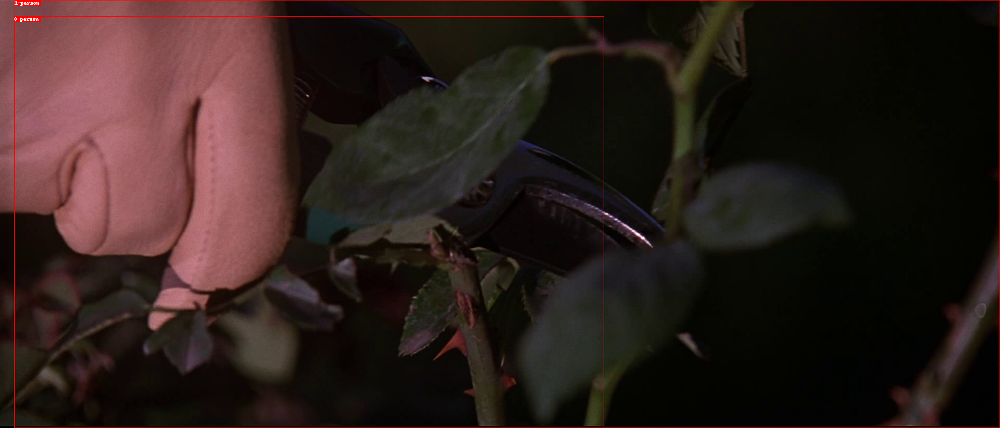

**************************************************
gt_boxes 0: 0-person
gt_boxes 1: 1-person
gt_boxes 2: 2-bird
**************************************************
pred_rels 0: ('55-person', 'holding', '79-leaf')
pred_rels 1: ('55-person', 'has', '1-head')
pred_rels 2: ('1-head', 'holding', '79-leaf')
pred_rels 3: ('79-leaf', 'in', '39-leaf')
pred_rels 4: ('79-leaf', 'in front of', '55-person')
pred_rels 5: ('1-head', 'of', '55-person')
pred_rels 6: ('1-head', 'holding', '31-leaf')
pred_rels 7: ('55-person', 'has', '36-arm')
pred_rels 8: ('31-leaf', 'behind', '55-person')
pred_rels 9: ('79-leaf', 'in', '3-leaf')
pred_rels 10: ('79-leaf', 'in', '31-leaf')
pred_rels 11: ('36-arm', 'holding', '79-leaf')
pred_rels 12: ('36-arm', 'of', '55-person')
pred_rels 13: ('79-leaf', 'in', '12-leaf')
pred_rels 14: ('55-person', 'holding', '31-leaf')
pred_rels 15: ('55-person', 'wearing', '3-leaf')
pred_rels 16: ('12-leaf', 'in front of', '55-person')
pred_rels 17: ('55-person', 'eating', '12-leaf')
pr

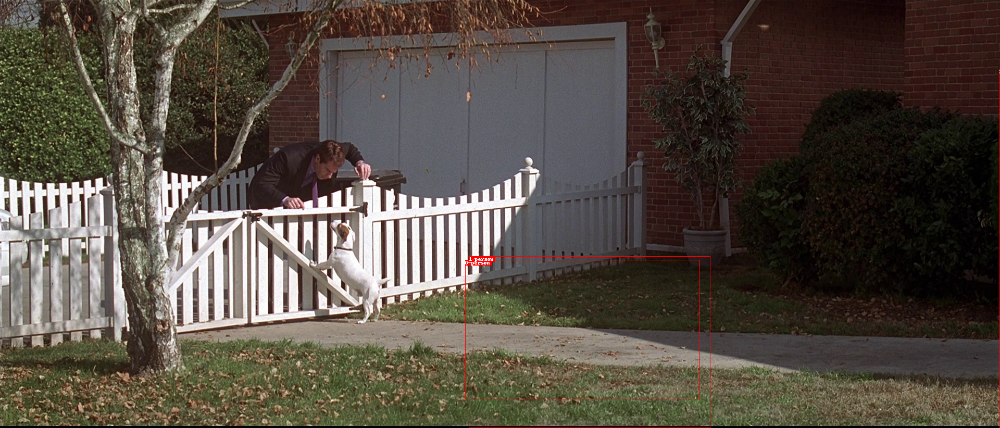

**************************************************
gt_boxes 0: 0-person
gt_boxes 1: 1-person
gt_boxes 2: 2-plant
**************************************************
pred_rels 0: ('2-building', 'behind', '19-fence')
pred_rels 1: ('2-building', 'behind', '16-man')
pred_rels 2: ('19-fence', 'in front of', '16-man')
pred_rels 3: ('19-fence', 'in front of', '2-building')
pred_rels 4: ('31-tree', 'behind', '16-man')
pred_rels 5: ('31-tree', 'behind', '19-fence')
pred_rels 6: ('19-fence', 'in front of', '31-tree')
pred_rels 7: ('2-building', 'behind', '31-tree')
pred_rels 8: ('0-tree', 'in', '8-pot')
pred_rels 9: ('55-fence', 'behind', '16-man')
pred_rels 10: ('16-man', 'standing on', '19-fence')
pred_rels 11: ('16-man', 'looking at', '0-tree')
pred_rels 12: ('31-tree', 'in front of', '2-building')
pred_rels 13: ('16-man', 'in front of', '2-building')
pred_rels 14: ('8-pot', 'near', '19-fence')
pred_rels 15: ('16-man', 'standing on', '8-pot')
pred_rels 16: ('55-fence', 'behind', '19-fence')
pr

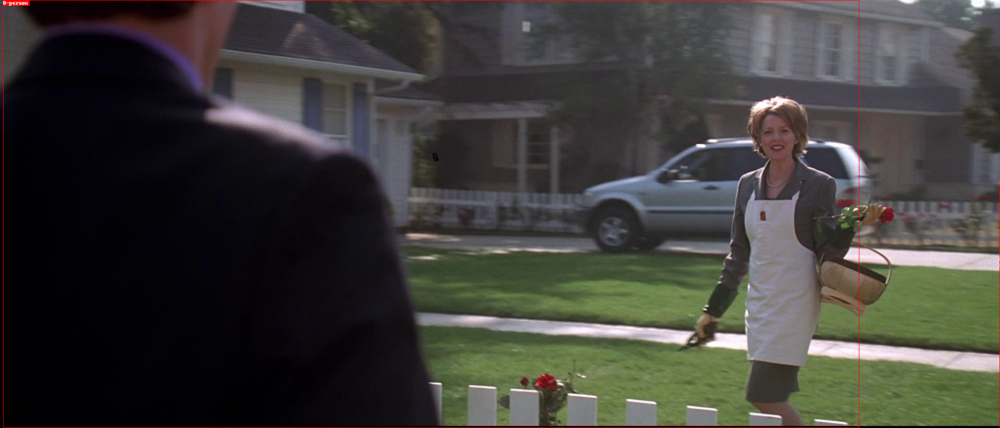

**************************************************
gt_boxes 0: 0-person
gt_boxes 1: 1-person
gt_boxes 2: 2-car
gt_boxes 3: 3-car
gt_boxes 4: 4-bag
**************************************************
pred_rels 0: ('2-building', 'behind', '3-woman')
pred_rels 1: ('2-building', 'behind', '1-man')
pred_rels 2: ('3-woman', 'in front of', '2-building')
pred_rels 3: ('1-man', 'in front of', '2-building')
pred_rels 4: ('3-woman', 'watching', '1-man')
pred_rels 5: ('1-man', 'watching', '3-woman')
pred_rels 6: ('3-woman', 'carrying', '69-bag')
pred_rels 7: ('4-house', 'behind', '1-man')
pred_rels 8: ('11-car', 'behind', '3-woman')
pred_rels 9: ('4-house', 'behind', '3-woman')
pred_rels 10: ('69-bag', 'in front of', '2-building')
pred_rels 11: ('1-man', 'in front of', '4-house')
pred_rels 12: ('11-car', 'behind', '1-man')
pred_rels 13: ('11-car', 'in front of', '2-building')
pred_rels 14: ('47-roof', 'behind', '1-man')
pred_rels 15: ('2-building', 'behind', '11-car')
pred_rels 16: ('1-man', 'holdi

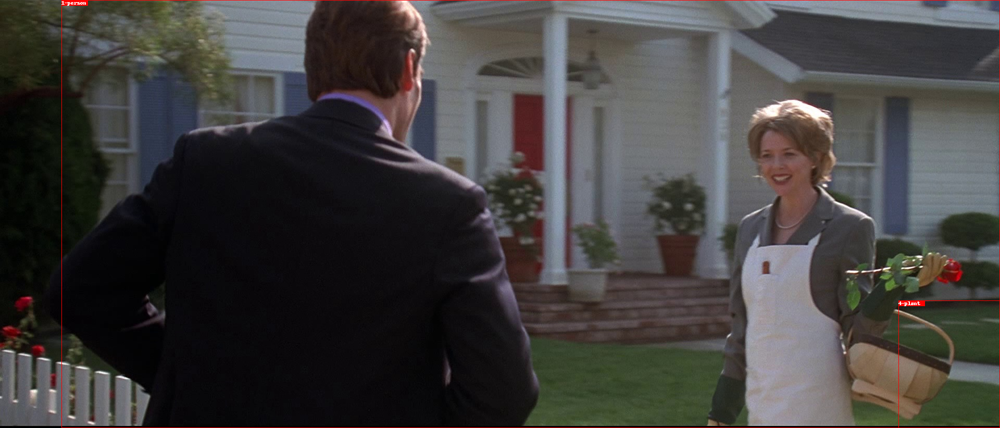

**************************************************
gt_boxes 0: 0-person
gt_boxes 1: 1-person
gt_boxes 2: 2-plant
gt_boxes 3: 3-plant
gt_boxes 4: 4-plant
**************************************************
pred_rels 0: ('5-plant', 'in', '1-pot')
pred_rels 1: ('9-fence', 'behind', '0-man')
pred_rels 2: ('68-plant', 'behind', '0-man')
pred_rels 3: ('17-woman', 'watching', '0-man')
pred_rels 4: ('8-pot', 'behind', '0-man')
pred_rels 5: ('0-man', 'watching', '17-woman')
pred_rels 6: ('1-pot', 'behind', '0-man')
pred_rels 7: ('47-plant', 'in', '8-pot')
pred_rels 8: ('1-pot', 'behind', '17-woman')
pred_rels 9: ('47-plant', 'in', '1-pot')
pred_rels 10: ('47-plant', 'behind', '0-man')
pred_rels 11: ('0-man', 'looking at', '5-plant')
pred_rels 12: ('41-house', 'behind', '0-man')
pred_rels 13: ('1-pot', 'with', '5-plant')
pred_rels 14: ('5-plant', 'behind', '17-woman')
pred_rels 15: ('0-man', 'wearing', '6-jacket')
pred_rels 16: ('68-plant', 'behind', '17-woman')
pred_rels 17: ('5-plant', 'behind'

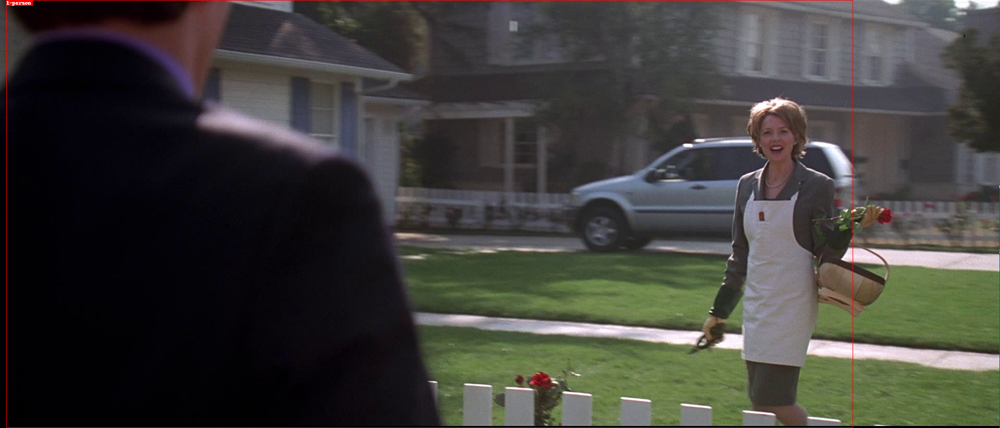

**************************************************
gt_boxes 0: 0-person
gt_boxes 1: 1-person
gt_boxes 2: 2-car
gt_boxes 3: 3-bag
**************************************************
pred_rels 0: ('4-building', 'behind', '2-man')
pred_rels 1: ('4-building', 'behind', '64-woman')
pred_rels 2: ('64-woman', 'watching', '2-man')
pred_rels 3: ('7-house', 'behind', '2-man')
pred_rels 4: ('2-man', 'watching', '64-woman')
pred_rels 5: ('64-woman', 'in front of', '4-building')
pred_rels 6: ('2-man', 'in front of', '4-building')
pred_rels 7: ('2-man', 'in front of', '7-house')
pred_rels 8: ('7-house', 'behind', '64-woman')
pred_rels 9: ('10-car', 'behind', '64-woman')
pred_rels 10: ('1-roof', 'behind', '2-man')
pred_rels 11: ('10-car', 'behind', '2-man')
pred_rels 12: ('8-window', 'behind', '2-man')
pred_rels 13: ('51-house', 'behind', '2-man')
pred_rels 14: ('10-car', 'in front of', '4-building')
pred_rels 15: ('4-building', 'behind', '10-car')
pred_rels 16: ('64-woman', 'in front of', '7-house')


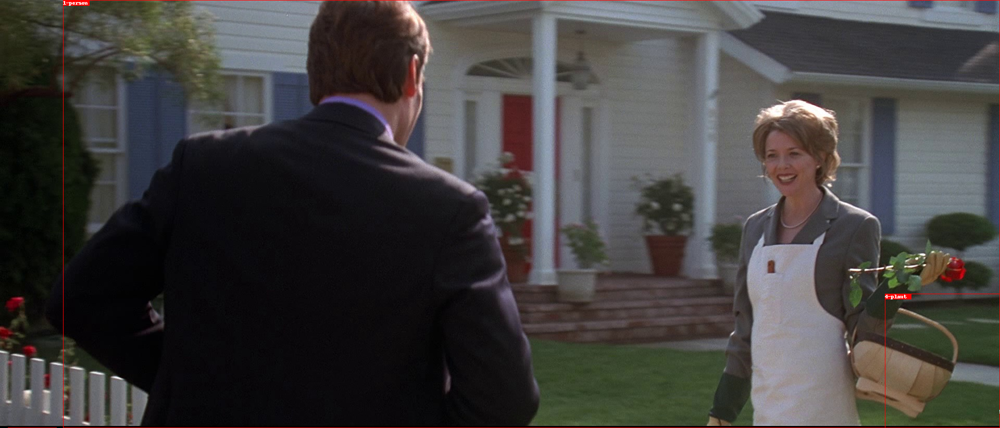

**************************************************
gt_boxes 0: 0-person
gt_boxes 1: 1-person
gt_boxes 2: 2-person
gt_boxes 3: 3-plant
gt_boxes 4: 4-plant
gt_boxes 5: 5-plant
**************************************************
pred_rels 0: ('5-plant', 'in', '1-pot')
pred_rels 1: ('43-plant', 'in', '1-pot')
pred_rels 2: ('1-pot', 'with', '5-plant')
pred_rels 3: ('1-pot', 'behind', '0-woman')
pred_rels 4: ('43-plant', 'in', '6-pot')
pred_rels 5: ('18-house', 'behind', '0-woman')
pred_rels 6: ('43-plant', 'behind', '0-woman')
pred_rels 7: ('6-pot', 'behind', '0-woman')
pred_rels 8: ('5-plant', 'behind', '0-woman')
pred_rels 9: ('2-plant', 'behind', '0-woman')
pred_rels 10: ('5-plant', 'in', '6-pot')
pred_rels 11: ('21-fence', 'behind', '0-woman')
pred_rels 12: ('0-woman', 'looking at', '5-plant')
pred_rels 13: ('2-plant', 'in', '1-pot')
pred_rels 14: ('0-woman', 'in front of', '18-house')
pred_rels 15: ('52-tree', 'behind', '0-woman')
pred_rels 16: ('6-pot', 'with', '43-plant')
pred_rels 17

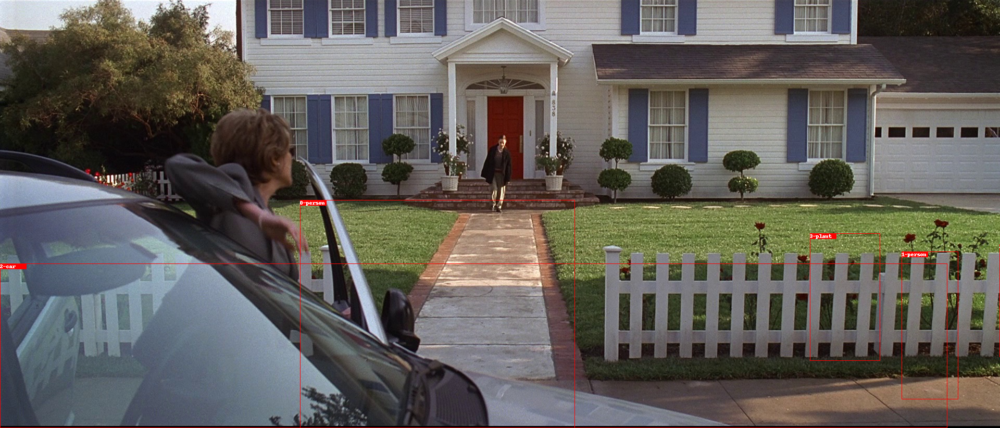

**************************************************
gt_boxes 0: 0-person
gt_boxes 1: 1-person
gt_boxes 2: 2-car
gt_boxes 3: 3-plant
gt_boxes 4: 4-plant
**************************************************
pred_rels 0: ('17-tree', 'behind', '49-boy')
pred_rels 1: ('9-woman', 'watching', '49-boy')
pred_rels 2: ('8-fence', 'in front of', '30-house')
pred_rels 3: ('17-tree', 'behind', '8-fence')
pred_rels 4: ('30-house', 'behind', '49-boy')
pred_rels 5: ('30-house', 'behind', '8-fence')
pred_rels 6: ('49-boy', 'in front of', '30-house')
pred_rels 7: ('17-tree', 'behind', '9-woman')
pred_rels 8: ('9-woman', 'in front of', '30-house')
pred_rels 9: ('49-boy', 'sitting on', '8-fence')
pred_rels 10: ('9-woman', 'walking on', '12-sidewalk')
pred_rels 11: ('30-house', 'behind', '9-woman')
pred_rels 12: ('8-fence', 'in front of', '9-woman')
pred_rels 13: ('8-fence', 'behind', '49-boy')
pred_rels 14: ('8-fence', 'in front of', '17-tree')
pred_rels 15: ('8-fence', 'in front of', '0-house')
pred_rels 16

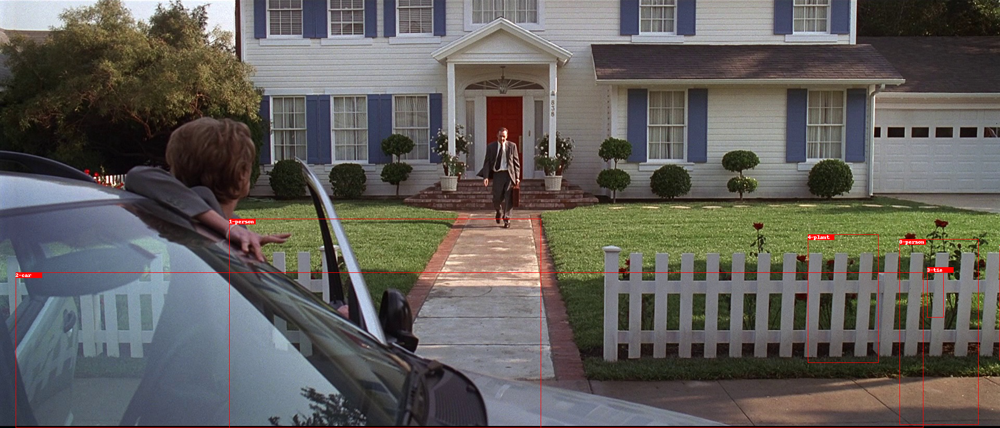

**************************************************
gt_boxes 0: 0-person
gt_boxes 1: 1-person
gt_boxes 2: 2-car
gt_boxes 3: 3-tie
gt_boxes 4: 4-plant
gt_boxes 5: 5-plant
**************************************************
pred_rels 0: ('13-tree', 'behind', '17-fence')
pred_rels 1: ('13-tree', 'behind', '50-boy')
pred_rels 2: ('17-fence', 'in front of', '0-house')
pred_rels 3: ('17-fence', 'in front of', '13-tree')
pred_rels 4: ('15-man', 'watching', '50-boy')
pred_rels 5: ('13-tree', 'behind', '15-man')
pred_rels 6: ('15-man', 'walking on', '21-sidewalk')
pred_rels 7: ('13-tree', 'behind', '24-plant')
pred_rels 8: ('17-fence', 'in front of', '16-house')
pred_rels 9: ('17-fence', 'in front of', '15-man')
pred_rels 10: ('21-sidewalk', 'near', '17-fence')
pred_rels 11: ('0-house', 'behind', '17-fence')
pred_rels 12: ('50-boy', 'wearing', '37-shirt')
pred_rels 13: ('50-boy', 'walking on', '21-sidewalk')
pred_rels 14: ('16-house', 'behind', '17-fence')
pred_rels 15: ('17-fence', 'behind', '50

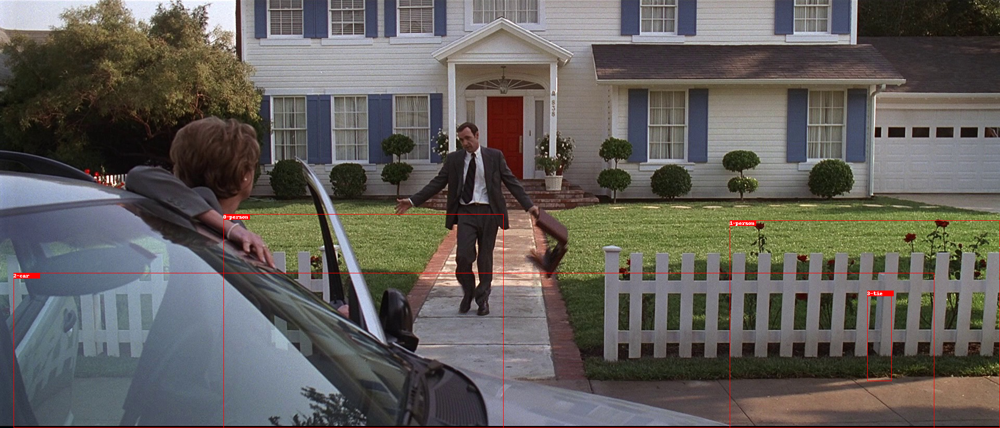

**************************************************
gt_boxes 0: 0-person
gt_boxes 1: 1-person
gt_boxes 2: 2-car
gt_boxes 3: 3-tie
gt_boxes 4: 4-plant
**************************************************
pred_rels 0: ('63-man', 'watching', '58-boy')
pred_rels 1: ('10-tree', 'behind', '12-fence')
pred_rels 2: ('10-tree', 'behind', '63-man')
pred_rels 3: ('10-tree', 'behind', '58-boy')
pred_rels 4: ('63-man', 'walking on', '14-sidewalk')
pred_rels 5: ('23-plant', 'behind', '63-man')
pred_rels 6: ('12-fence', 'in front of', '0-house')
pred_rels 7: ('5-door', 'behind', '63-man')
pred_rels 8: ('0-house', 'behind', '63-man')
pred_rels 9: ('63-man', 'in front of', '0-house')
pred_rels 10: ('12-fence', 'near', '63-man')
pred_rels 11: ('12-fence', 'in front of', '10-tree')
pred_rels 12: ('63-man', 'in front of', '5-door')
pred_rels 13: ('0-house', 'behind', '58-boy')
pred_rels 14: ('0-house', 'behind', '12-fence')
pred_rels 15: ('58-boy', 'looking at', '63-man')
pred_rels 16: ('12-fence', 'behind',

In [80]:
# ndetected_origin_result['predictions'][0].get_field('pred_labels').tolist()
# get image info by index
def get_info_by_idx(idx, det_input, thres=0.5):
    groundtruth = det_input['groundtruths'][idx]
    prediction = det_input['predictions'][idx]
    # image path
    img_path = ndetected_info[idx]['img_file']
    # boxes
    boxes = groundtruth.bbox
    # object labels
    idx2label = vocab_file['idx_to_label']
    labels = ['{}-{}'.format(idx,idx2label[str(i)]) for idx, i in enumerate(groundtruth.get_field('labels').tolist())]
    pred_labels = ['{}-{}'.format(idx,idx2label[str(i)]) for idx, i in enumerate(prediction.get_field('pred_labels').tolist())]
    # groundtruth relation triplet
    idx2pred = vocab_file['idx_to_predicate']
    gt_rels = None
#     gt_rels = None = groundtruth.get_field('relation_tuple').tolist()
#     gt_rels = [(labels[i[0]], idx2pred[str(i[2])], labels[i[1]]) for i in gt_rels]
    # prediction relation triplet
    pred_rel_pair = prediction.get_field('rel_pair_idxs').tolist()
    pred_rel_label = prediction.get_field('pred_rel_scores')
    pred_rel_label[:,0] = 0
    pred_rel_score, pred_rel_label = pred_rel_label.max(-1)
    #mask = pred_rel_score > thres
    #pred_rel_score = pred_rel_score[mask]
    #pred_rel_label = pred_rel_label[mask]
    pred_rels = [(pred_labels[i[0]], idx2pred[str(j)], pred_labels[i[1]]) for i, j in zip(pred_rel_pair, pred_rel_label.tolist())]
    return img_path, boxes, labels, gt_rels, pred_rels, pred_rel_score, pred_rel_label

def draw_single_box(pic, box, color='red', draw_info=None):
    draw = ImageDraw.Draw(pic)
    x1,y1,x2,y2 = int(box[0]), int(box[1]), int(box[2]), int(box[3])
    draw.rectangle(((x1, y1), (x2, y2)), outline=color)
    if draw_info:
        draw.rectangle(((x1, y1), (x1+50, y1+10)), fill=color)
        info = draw_info
        draw.text((x1, y1), info)

def print_list(name, input_list):
    for i, item in enumerate(input_list):
        print(name + ' ' + str(i) + ': ' + str(item))
    
def draw_image(img_path, boxes, labels, gt_rels, pred_rels, pred_rel_score, pred_rel_label, print_img=True):
    pic = Image.open(img_path)
    num_obj = boxes.shape[0]
    for i in range(num_obj):
        info = labels[i]
        draw_single_box(pic, boxes[i], draw_info=info)
    if print_img:
        display(pic)
    if print_img:
        print('*' * 50)
        print_list('gt_boxes', labels)
        print('*' * 50)
#         print_list('gt_rels', gt_rels)
#         print('*' * 50)
    print_list('pred_rels', pred_rels[:20])
    print('*' * 50)
    
    return None

def show_selected(idx_list):
    for select_idx in idx_list:
        print(select_idx)
        draw_image(*get_info_by_idx(select_idx, ndetected_origin_result))
        
def show_all(start_idx, length):
    for cand_idx in range(start_idx, start_idx+length):
        print(cand_idx)
        draw_image(*get_info_by_idx(cand_idx, ndetected_origin_result))
        
show_all(start_idx=0, length=10)
#show_selected([119, 967, 713, 5224, 19681, 25371])